# Overvew

- hard labeling を行なう。
- 各wavファイル5秒ごとにラベルを付与する。
- nb017_event_rms を使用する。

# CONST

In [91]:
NB = '023'
DEBUG = False
PATH_EVENT = './../data_ignore/event/nb017_event_rms/nb017_event_rms.csv'
DATASET = '32khz'
SR_FEAT = 4

# Import everything I need :)

In [147]:
import os
import gc
import cv2 
import time
import yaml
import glob
import random
import librosa
import numpy as np
import pandas as pd
import seaborn as sns
import IPython.display
import soundfile as sf
from pathlib import Path
from scipy.io import wavfile
import matplotlib.pyplot as plt
from fastprogress import progress_bar
from sklearn.metrics import f1_score
from sklearn.model_selection import StratifiedKFold

import torch
import torch.nn as nn
from torchvision import models
import torch.utils.data as data

import sys
sys.path.insert(0, './../src/util/')
from const import BIRD_CODE, INV_BIRD_CODE

# My function

In [13]:
def string_to_list(list_str):
    for str_replace in ['\n', '[', ']']:
        list_str = list_str.replace(str_replace, '')

    split = list_str.split(' ')
    events_num = []
    for text in split:
        try:
            num = np.float32(text)
            events_num.append(num)
        except:
            pass
    return events_num

# Preparation

set

In [69]:
pd.set_option('display.max_columns', 100)

<br> 

data path

In [84]:
path_wav_list = glob.glob('./../data_ignore/external_dataset/32khz/*/*/*.wav')

<br>

load data

In [24]:
train_csv= pd.read_csv(train_resampled_audio_dirs[0] / "train_mod.csv")
df_event = pd.read_csv(PATH_EVENT)

In [25]:
lists = []
event_list = df_event['event_sec_list'].values
for event_str in progress_bar(event_list):
    lists.append(string_to_list(event_str))
df_event['event_sec_list'] = lists

# EDA

ebird_code ごとでwavファイルがどれだけあるかチェック

In [50]:
vc = train_csv['ebird_code'].value_counts()

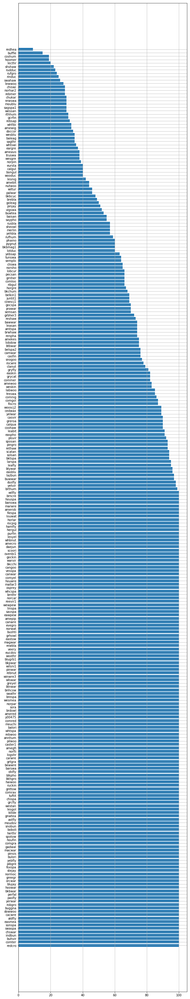

In [59]:
plt.figure(figsize=(10, 60))
plt.barh(vc.index, vc.values)
plt.grid()

<br>

## 1つのwavfileで挙動を確認する

In [196]:
idx = 19
filename = df_event.filename[idx]
event_sec_list = np.array(df_event.event_sec_list[idx])
bird_code = train_csv.query('resampled_filename==@filename')['ebird_code'].values

for path in path_wav_list:
    if filename in path:
        path_audio = path
        signal, sr = sf.read(path_audio)
        
# res = 100
# x_sec = np.arange(len(signal))/sr
# plt.figure(figsize=(20, 5))
# plt.plot(x_sec[::res], signal[::res], label='signal')
# plt.title(path_audio)
# for i, event_sec in enumerate(event_sec_list):
#     label ='event' if i==1 else None
#     plt.axvline(event_sec, ymin=0, ymax=0.1, color='r', label=label)
# plt.legend()

<br>

event plot

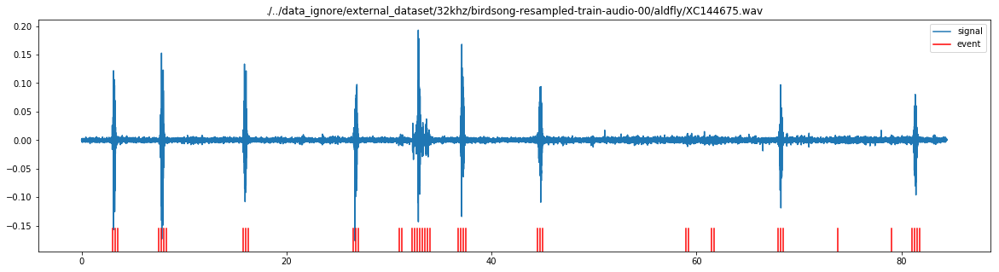

In [197]:
res = 100
x_sec = np.arange(len(signal))/sr
plt.figure(figsize=(20, 5))
plt.plot(x_sec[::res], signal[::res], label='signal')
plt.title(path_audio)
for i, event_sec in enumerate(event_sec_list):
    label ='event' if i==1 else None
    plt.axvline(event_sec, ymin=0, ymax=0.1, color='r', label=label)
plt.legend()

<br>

5secで区切る

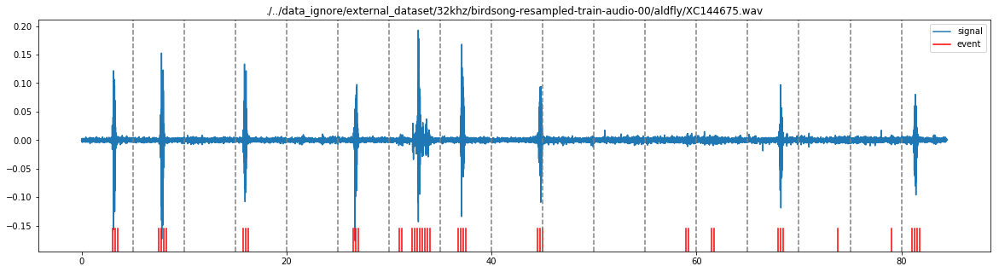

In [198]:
res = 100
x_sec = np.arange(len(signal))/sr
plt.figure(figsize=(20, 5))
plt.plot(x_sec[::res], signal[::res], label='signal')
plt.title(path_audio)
for i, event_sec in enumerate(event_sec_list):
    label ='event' if i==1 else None
    plt.axvline(event_sec, ymin=0, ymax=0.1, color='r', label=label)
for i in range(1, int(len(signal)/sr//5) + 1):
    plt.axvline(i*5, linestyle='--', color='gray')

plt.legend()

<br>

nocall であると思われる部分(赤い線がないところ)には灰色を塗る  
境界に含まれていれば、eventとみなす。

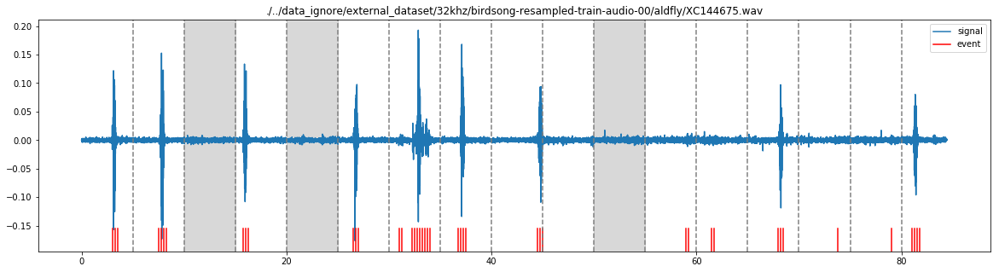

In [199]:
res = 100
x_sec = np.arange(len(signal))/sr
plt.figure(figsize=(20, 5))
plt.plot(x_sec[::res], signal[::res], label='signal')
plt.title(path_audio)
for i, event_sec in enumerate(event_sec_list):
    label ='event' if i==1 else None
    plt.axvline(event_sec, ymin=0, ymax=0.1, color='r', label=label)
for i in range(0, int(len(signal)/sr//5)):
    plt.axvline((i+1)*5, linestyle='--', color='gray')
    
    bools = (i*5 <= event_sec_list) & (event_sec_list <= (i+1)*5)
    if any(bools):
        pass
    else: # event が一つも含まれていなければ
        plt.axvspan(i*5, (i+1)*5, color='gray', alpha=0.3)

plt.legend()
IPython.display.display(IPython.display.Audio(signal, rate=sr))

---> 小さい鳥の声入ってるけどどうしよう...

# 関数を作って、いくつかのwavファイルで可視化してみる。

In [204]:
def show_label_section(filename, show_audio=False):
    event_sec_list = np.array(df_event.event_sec_list[idx])
    bird_code = train_csv.query('resampled_filename==@filename')['ebird_code'].values

    for path in path_wav_list:
        if filename in path:
            path_audio = path
            signal, sr = sf.read(path_audio)

    res = 100
    x_sec = np.arange(len(signal))/sr
    plt.figure(figsize=(20, 3))
    plt.plot(x_sec[::res], signal[::res], label='signal')
    plt.title(path_audio)
    for i, event_sec in enumerate(event_sec_list):
        label ='event' if i==1 else None
        plt.axvline(event_sec, ymin=0, ymax=0.1, color='r', label=label)
#     for i in range(1, int(len(signal)/sr//5) + 1):
    for i in range(0, int(len(signal)/sr//5)):
        plt.axvline((i+1)*5, linestyle='--', color='gray')

        bools = (i*5 <= event_sec_list) & (event_sec_list <= (i+1)*5)
        if any(bools):
            pass
        else: # event が一つも含まれていなければ
            plt.axvspan(i*5, (i+1)*5, color='gray', alpha=0.3)

    plt.legend()
    if show_audio:
        IPython.display.display(IPython.display.Audio(signal, rate=sr))

# nocall?(灰色) 部分を聞いてみる

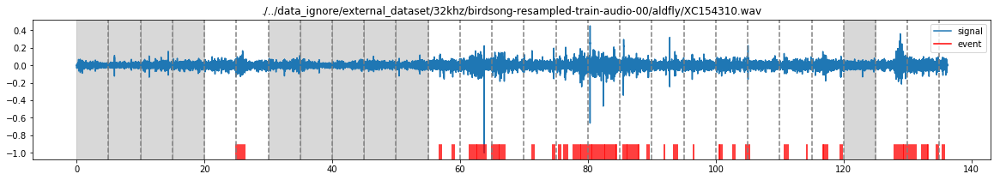

In [212]:
idx = 20
filename = df_event.filename[idx]
show_label_section(filename, show_audio=True)

---> bad case

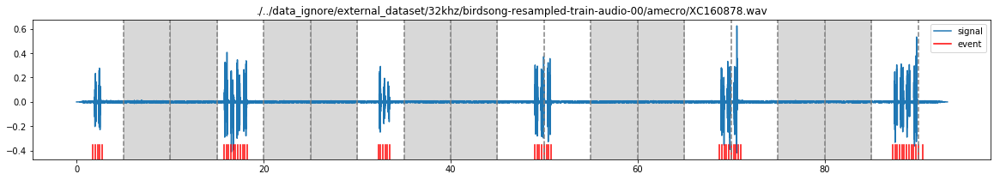

In [220]:
idx = 207
filename = df_event.filename[idx]
show_label_section(filename, show_audio=True)

---> good case

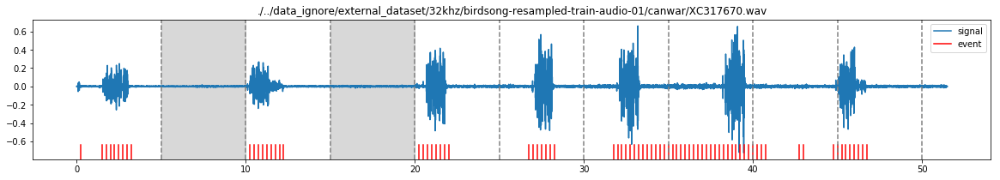

In [221]:
idx = 5000
filename = df_event.filename[idx]
show_label_section(filename, show_audio=True)

---> bad case

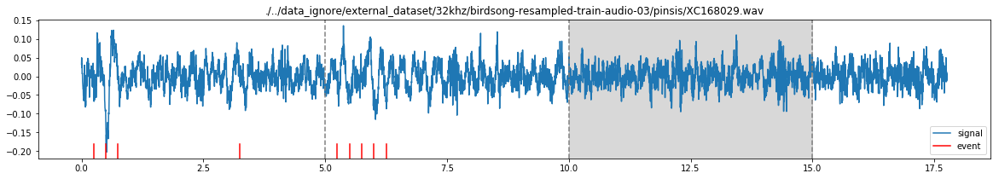

In [239]:
idx = 15005
filename = df_event.filename[idx]
show_label_section(filename, show_audio=True)

---> bad case

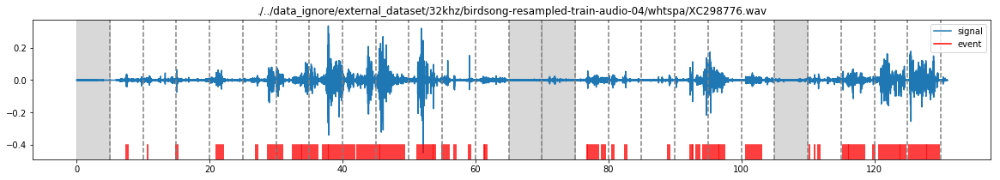

In [251]:
idx = 20010
filename = df_event.filename[idx]
show_label_section(filename, show_audio=True)

---> bad case

# 結論
- この手法で、nocall を抽出するのは、難しそう。
- rmsは音大きさを見ているがそれだけでは、だめっぽい。。。